# Midterm

In [1]:
%matplotlib inline
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from imblearn.over_sampling import RandomOverSampler
import pandas as pd
import seaborn as sns

data=pd.read_csv('train_covid.csv')

"""
mean_hh_cli_ct                                            4784 non-null   float64
pct_worried_finances                                      0 non-null      float64
pct_cmnty_cli                                             4804 non-null   float64

"""
#date不是一個特徵值，除非使用OrdinalEncoder，轉換成數列
#如果test的data是未來的這個特徵值，我認為不是一個好的分類指標
#而pct_worried_finances都是NaN可以直接drop掉
data=data.drop(["date","pct_worried_finances"],axis=1)
data.iloc[:,3:] =data.iloc[:,3:].astype("float32")
#分割feature和label
length=data.shape[1]
X=data.iloc[:,0:length-1]
y=data.iloc[:,length-1]
X.fillna(np.nan)
X.replace([np.inf, -np.inf], np.nan, inplace=True)


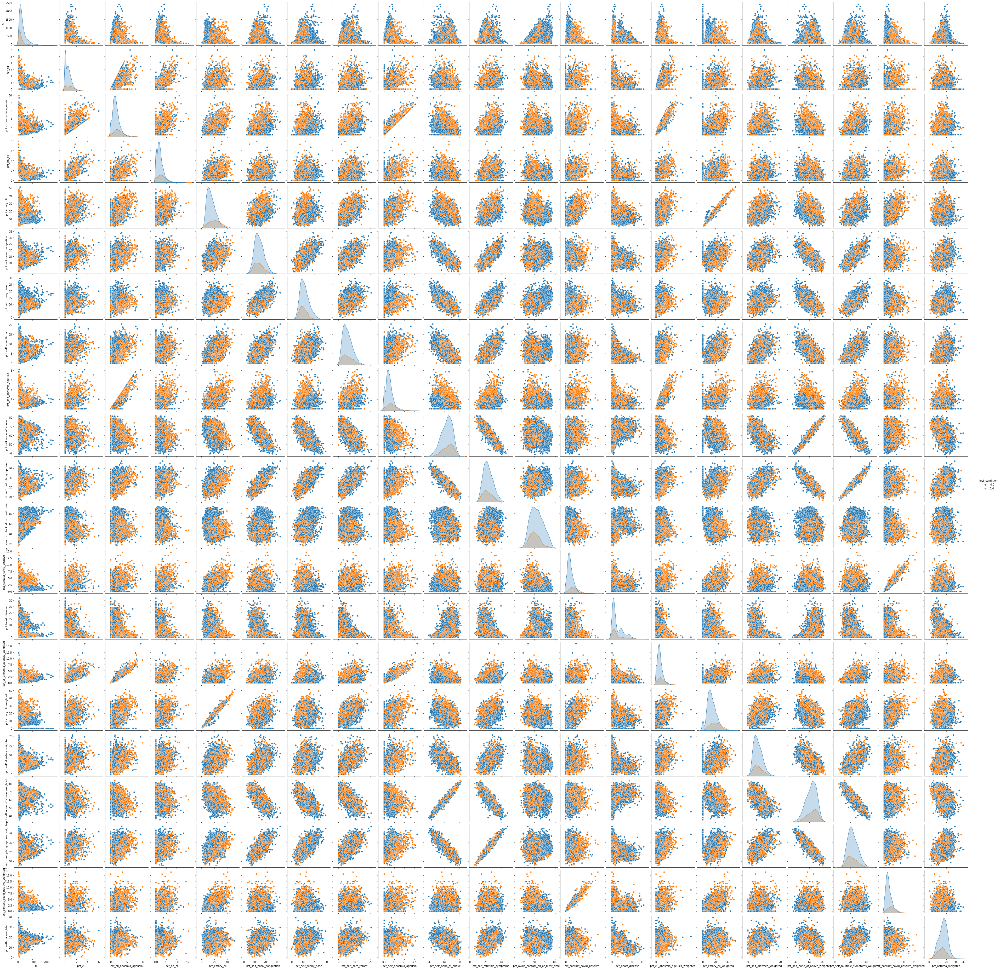

In [7]:

# encoder = TargetEncoder()
# X['state_code'] = encoder.fit_transform(X['state_code'], y)
index_list=[0, 3, 5, 7, 8, 9, 22, 23, 25, 29, 31, 32, 34, 38, 41, 51, 53, 73, 76, 77, 83, 88]
index_list.append(94)
data_select=data.iloc[:,index_list]

# x_select_0=X.iloc[:,[0, 4, 6, 20, 28, 35, 42, 80]]
# x_select_0=x_select_0[y==0]
# x_select_1=X.iloc[:,[0, 4, 6, 20, 28, 35, 42, 80]]
# x_select_1=x_select_0[y==1]
# x_select_0.plot(kind='density', subplots=True, layout=(4,2), sharex=False)
# sns.pairplot(data_select,hue="test_condition",height=2.5)
# plt.show()

In [ ]:
data[rus.sample_indices_,:]

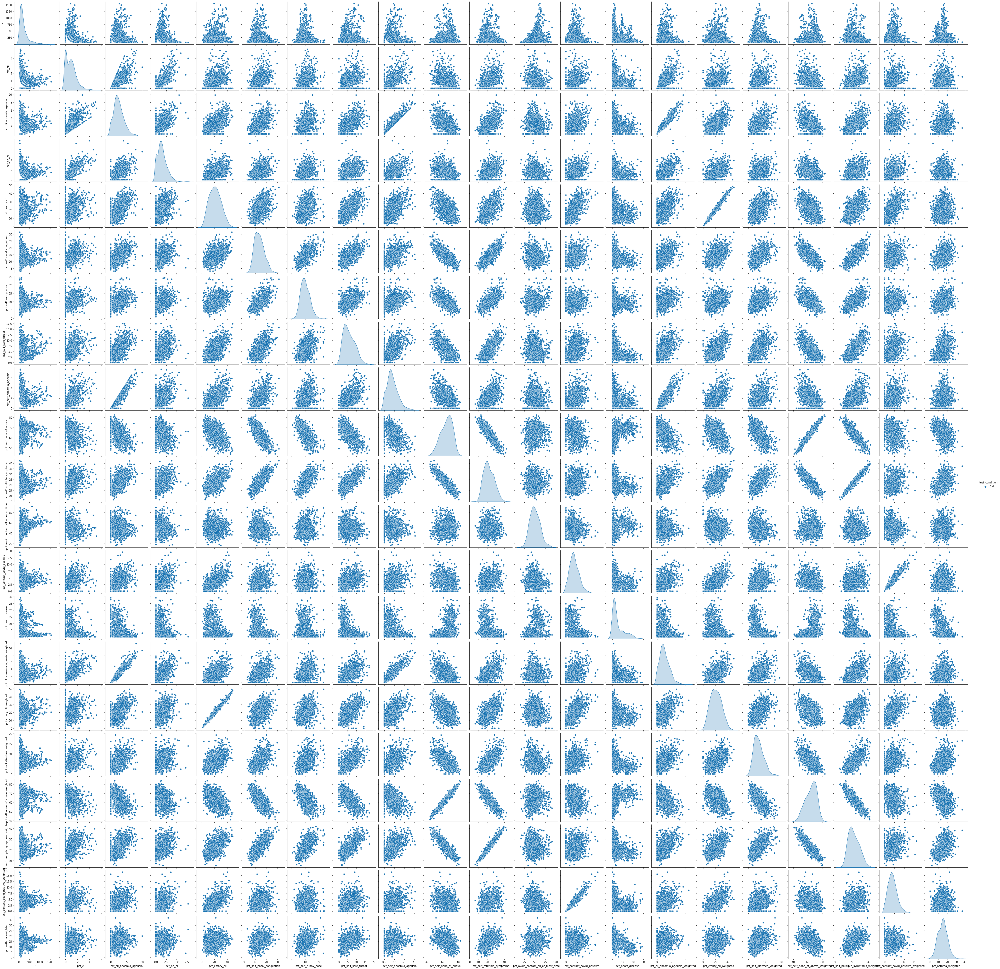

In [60]:
# data_select=data.iloc[:,index_list]
# data_select=data_select[data_select["test_condition"]==1]
# sns.pairplot(data_select,hue="test_condition",height=2.5)
# plt.show()
# data_select

In [4]:
data_select

,state_code,weight_sums,pct_ili,pct_self_difficulty_breathing,pct_self_diarrhea,mean_outside_hh_contact_at_work_ct,pct_high_blood_pressure,mean_outside_hh_contact_at_work_ct_weighted,test_condition
0,az,7.178188e+05,2.0927,4.9327,11.3602,6.6443,19.679300,6.322100,0.0
1,fl,2.440767e+06,1.0239,2.3891,6.6553,7.3309,19.354799,5.258900,0.0
3,in,6.789525e+05,1.7264,3.0544,9.9602,6.8648,9.920600,5.706000,0.0
4,in,8.263480e+05,0.2309,1.1547,5.5427,2.2346,48.611099,0.884600,0.0
5,la,5.179155e+05,0.8247,2.0619,9.8969,5.1844,29.038900,3.731000,0.0
...,...,...,...,...,...,...,...,...,...
4992,tn,7.497681e+05,0.0000,4.1667,2.0833,7.9444,62.105301,5.247000,0.0
4993,tx,2.632971e+06,1.1062,2.2124,7.9646,8.3264,7.675400,6.795100,0.0
4995,tx,2.137299e+06,0.5076,2.0305,4.5685,23.6313,16.582899,25.399099,0.0
4996,wa,8.556169e+05,0.0000,2.5105,2.9289,3.9745,41.422600,2.425400,0.0


 <font size="4">

## Data Prepare

1. ColumTransformer & sklearn.compose.make_column_selector
   1. for int or float Using **StandardScaler() -> SimpleImputer(missing_values=np.nan, strategy='mean')->RobustScaler** 
   2. for str or object Using **OneHotencoder()/Target Encoding()**
2. 


</font> 

## load package

In [2]:
from sklearn.compose import make_column_transformer
from sklearn.compose import make_column_selector as selector
from sklearn.ensemble import RandomForestClassifier
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import RobustScaler
from sklearn.preprocessing import MinMaxScaler
from sklearn.preprocessing import OneHotEncoder
from sklearn.pipeline import make_pipeline
from sklearn.model_selection import cross_validate
from sklearn.metrics import mean_absolute_error
from sklearn.pipeline import Pipeline
import xgboost as xgb
from imblearn.under_sampling import RandomUnderSampler
from sklearn.model_selection import GridSearchCV
from imblearn.pipeline import make_pipeline as make_pipeline_with_sampler
from imblearn.under_sampling import CondensedNearestNeighbour 
from imblearn.under_sampling import TomekLinks
from category_encoders import TargetEncoder
from imblearn.over_sampling import SMOTE
from sklearn.ensemble import RandomForestClassifier, VotingClassifier
def feacture_selection(X_res):
    index_list=[0, 3, 5, 7, 8, 9, 22, 23, 25, 29, 31, 32, 34, 38, 41, 51, 53, 73, 76, 77, 83, 88]
    X_sel=X_res[:,index_list] #from RFECV 
    return X_sel 
    
class Random_undersample_sort():
    def __init__(self,random_state=42) -> None:
        self.random_state=random_state
        

    def fit_resample(self,X, y):
        rus = RandomUnderSampler(random_state=self.random_state)
        rus.fit_resample(X,y)
        rus.sample_indices_.sort()
        X=X[rus.sample_indices_,:]
        y=y[rus.sample_indices_]
        X_pre, y_res = rus.fit_resample(X, y)
        
        return X_pre, y_res

## sklearn.feature_selection.RFECV

In [54]:
# XGBClassifier=xgb.XGBClassifier(objective= 'binary:logistic',eval_metric='mlogloss',
#     tree_method="gpu_hist",enable_categorical=True, use_label_encoder=False,
#     seed=42,learning_rate=0.05,max_depth=6,min_child_weight=11,subsample=0.8,colsample_bytree=0.7,n_estimators=100,gamma=0.2)
# num_pipe = make_pipeline(
#     SimpleImputer(missing_values=np.nan, strategy='mean'),StandardScaler(),
#     MinMaxScaler(feature_range=(1, 100))
    
# )
# cat_pipe = make_pipeline(
#     SimpleImputer(missing_values=np.nan, strategy='most_frequent'),
#     TargetEncoder()
# )    
# preprocessor = make_column_transformer(
#     (cat_pipe, selector(dtype_exclude="number")),
#     (num_pipe, selector(dtype_include="number"))
   
#     # remainder='passthrough'
    
# )
# preparedata=make_pipeline_with_sampler(
#     preprocessor,RandomUnderSampler(random_state=42)
# )

# X_pre=preprocessor.fit_transform(X,y)
# rus = RandomUnderSampler(random_state=42)
# X_res, y_res = rus.fit_resample(X_pre, y)

# X_pre

array([[4.08759117e-01, 1.98949650e-01, 2.51916766e-01, ...,
        4.62881853e+01, 5.36794323e+01, 2.89189838e+01],
       [3.43750000e-01, 1.98949650e-01, 2.51916766e-01, ...,
        4.16943668e+01, 5.85106287e+01, 3.10405739e+01],
       [3.21739137e-01, 2.79636979e-01, 2.06855088e-01, ...,
        1.70952433e+01, 6.84758810e+00, 6.52051134e+01],
       ...,
       [6.29921257e-02, 2.79636979e-01, 2.20383853e-01, ...,
        6.67954227e+00, 1.00000000e+02, 6.41317210e+00],
       [6.29921257e-02, 2.79636979e-01, 2.06855088e-01, ...,
        1.68820922e+01, 2.21963235e+01, 5.79521332e+01],
       [1.29770994e-01, 2.79636979e-01, 2.06855088e-01, ...,
        2.71140558e+01, 2.14575779e+01, 6.78167554e+01]])

In [28]:
# print(preprocessor.fit_transform(X,y).shape)
# print(X.shape)
# X_pre=preprocessor.fit_transform(X,y)
# rus = RandomUnderSampler(random_state=42)
# X_res, y_res = rus.fit_resample(X_pre, y)
# print(X_res.shape)
# # print(type(X_res))
# # y_res=pd.DataFrame(y_res)
# # print(y_res.shape)

Optimal number of features : 22


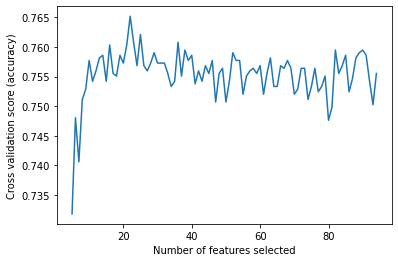

In [55]:
# from sklearn.feature_selection import RFECV
# min_features_to_select = 5  # Minimum number of features to consider
# rfecv = RFECV(
#     estimator=XGBClassifier,
#     step=1,
#     cv=5,
#     scoring="accuracy",
#     min_features_to_select=min_features_to_select,
# )
# rfecv.fit(X_res,y_res)
# print("Optimal number of features : {}".format(rfecv.n_features_))

# # Plot number of features VS. cross-validation scores
# plt.figure()
# plt.xlabel("Number of features selected")
# plt.ylabel("Cross validation score (accuracy)")
# plt.plot(
#     range(min_features_to_select, len(rfecv.grid_scores_) + min_features_to_select),
#     rfecv.grid_scores_,
# )
# plt.show()


In [56]:
index_list=[]
for index,i in enumerate(rfecv.ranking_):
    if i == 1: 
        # print(index)
        index_list.append(index)
# feacture_extraction(X_pre)
# X_res[:,index_list].shape

# RFECV_result
index_list_result=[0, 4, 6, 20, 28, 35, 42, 80]
print(index_list)

[0, 3, 5, 7, 8, 9, 22, 23, 25, 29, 31, 32, 34, 38, 41, 51, 53, 73, 76, 77, 83, 88]


```python
rfecv.ranking_
[ 1, 30, 18, 54,  1,  9,  1, 26, 55, 43, 59, 32, 74, 81, 53, 35, 19,
       36, 13, 11,  1, 23, 17, 66, 33, 39,  7, 44,  1,  4, 67, 15, 76, 79,
       78,  1, 22, 34, 40, 62, 48, 57,  1, 58, 41, 21, 52, 73, 14, 37,  6,
       83, 31, 69, 27, 50, 42, 82, 75, 60, 38, 29, 12, 72, 51, 24, 47,  8,
       68, 49, 16, 20, 70,  2,  3, 64, 25, 77, 80, 84,  1,  5, 56, 71, 65,
       28, 63, 10, 46, 45, 61]
```

In [9]:
# rfecv.ranking_
# index_list=[]
# for index,i in enumerate(rfecv.ranking_):
#     if i == 1 or i == 2 or i == 3 or i == 4 : 
        
#         index_list.append(index)
# rfecv.ranking_

In [11]:
import re

pattern=re.compile("^xgbclassifier__o.*")
clf_keys=list(clf_keys)
for i in clf_keys:
    k=re.findall(pattern,i)
    if k==[]:pass
    else:
        print(k)

NameError: name 'clf_keys' is not defined

# SVC

## Make Pipeline

In [3]:
num_pipe = make_pipeline_with_sampler(
    SimpleImputer(missing_values=np.nan, strategy='mean'),StandardScaler(), MinMaxScaler(feature_range=(1, 100))
    
)
cat_pipe = make_pipeline_with_sampler(
    SimpleImputer(missing_values=np.nan, strategy='mean'),
    # TargetEncoder()
)    
preprocessor = make_column_transformer(
    (num_pipe, selector(dtype_include="number")),
    (cat_pipe, selector(dtype_include="category")),
    remainder='passthrough'
    
)
preparedata=make_pipeline_with_sampler(
    preprocessor,RandomUnderSampler(random_state=42)
)

X_pre=preprocessor.fit_transform(X,y)
rus = RandomUnderSampler(random_state=42)
X_res, y_res = rus.fit_resample(X_pre, y)
# sklearn.feature_selection.RFECV
X_sel=feacture_selection(X_res) #from RFECV 
y_sel=y_res
# svc=SVC(gamma='auto',random_state=42)
# clf = make_pipeline_with_sampler(
#     svc
# )
# clf.get_params().keys()
X_pre.shape

(5000, 94)

## Model Training

In [4]:
# from sklearn.model_selection import TimeSeriesSplit
param_grid = { 
    # "condensednearestneighbour__sampling_strategy":["all","not majority"],
    
    
    
}
# GridSearchCV : refit==True 會重新用整個data重新訓練一次
gs=GridSearchCV(estimator=clf,
               param_grid=param_grid,
               scoring={"f1": "f1", "f1_weighted accuracy": "f1_weighted"},
               refit="f1_weighted accuracy",
               return_train_score=True,
               cv=5,
            # cv=TimeSeriesSplit(),
               n_jobs = -1,
              )
gs=gs.fit(X_sel,y_res)

NameError: name 'clf' is not defined

## Recodr Model Training Result

In [39]:
# print(gs.best_params_)

# df=pd.DataFrame(gs.cv_results_)
# gs.cv_results_.keys()
# gs.best_estimator_
# gs.cv_results_.keys()
print(gs.best_score_)


0.7069847181267177


In [40]:
index=[]
index+= ["svc+undersample+RFECV"]
scores = {"f1": [], "f1_weighted accuracy": []}

scores["f1"].append(gs.cv_results_["mean_test_f1"].mean())
scores["f1_weighted accuracy"].append(gs.cv_results_["mean_test_f1_weighted accuracy"].mean())

df_scores = pd.DataFrame(scores,index)
print(df_scores)

                             f1  f1_weighted accuracy
svc+undersample+RFECV  0.305013              0.705013


In [ ]:
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay

X_pred=preprocessor.transform(X)

X_pred=feacture_selection(X_pred)
y_pred=gs.best_estimator_.predict(X_pred)
cm=confusion_matrix(y, y_pred)
cm = confusion_matrix(y, y_pred)
disp = ConfusionMatrixDisplay(confusion_matrix=cm,
                              )
disp.plot()

plt.show()

## test data 訓練

In [59]:

test=pd.read_csv("test_covid.csv")

"""
mean_hh_cli_ct                                            4784 non-null   float64
pct_worried_finances                                      0 non-null      float64
pct_cmnty_cli                                             4804 non-null   float64

"""
# test=test.drop(['date', 'state_code', 'gender', 'age_bucket',"mean_hh_cli_ct","pct_worried_finances","pct_cmnty_cli"],axis=1)

X_test=test.drop(["date","pct_worried_finances"],axis=1)
X_test=preprocessor.transform(X_test)
X_test=feacture_selection(X_test)
X_test.shape

(906, 8)

In [61]:
y_test=gs.best_estimator_.predict(X_test)
y_test=y_test.astype(np.int64)
col=['test_condition']
df=pd.DataFrame(y_test,columns=col)
df.to_csv('svc.csv', index = True,index_label='id') 


## Record Model Score

In [ ]:
scores.update({"kaggle score":[]})
scores["kaggle score"].append(0.652)
df_scores = pd.DataFrame(scores,index)
print(df_scores)

                                       f1  f1_weighted accuracy  kaggle score
XGBClassifier+undersample+RFECV  0.755861              0.761762         0.652


In [ ]:
Total_df_scores=pd.read_excel("實驗數據\不同模型分數.xlsx",index_col=0)
Total_df_scores=pd.concat([Total_df_scores,df_scores])
Total_df_scores.to_excel("實驗數據\不同模型分數.xlsx")

# XGBClassifier

## Make Pipeline

In [3]:
num_pipe = make_pipeline_with_sampler(
    SimpleImputer(missing_values=np.nan, strategy='mean'),StandardScaler(), MinMaxScaler(feature_range=(1, 100))
    
)
cat_pipe = make_pipeline_with_sampler(
    SimpleImputer(missing_values=np.nan, strategy='most_frequent'),
    TargetEncoder()
)    
preprocessor = make_column_transformer(
    (cat_pipe, selector(dtype_exclude="number")),
    (num_pipe, selector(dtype_include="number")),
    
)
preparedata=make_pipeline_with_sampler(
    preprocessor,RandomUnderSampler(random_state=42)
)
# rus = Random_undersample_sort(random_state=42)
# X_pre, y_res = rus.fit_resample(X, y)
# X_res=preprocessor.fit_transform(X_pre,y_res)


# # # sklearn.feature_selection.RFECV
# X_sel=feacture_selection(X_res) #from RFECV 
# y_sel=y_res

X_pre=preprocessor.fit_transform(X,y)
rus = Random_undersample_sort(random_state=42)
X_res, y_res = rus.fit_resample(X_pre, y)
# sklearn.feature_selection.RFECV
X_sel=feacture_selection(X_res) #from RFECV 
y_sel=y_res

XGBClassifier= xgb.XGBClassifier(objective= 'binary:logistic',eval_metric='mlogloss',
    tree_method="gpu_hist",enable_categorical=True, use_label_encoder=False,
    seed=42,learning_rate=0.05,max_depth=6,min_child_weight=11,subsample=0.8,colsample_bytree=0.7,n_estimators=1000,gamma=0.2)
clf = make_pipeline_with_sampler(
    XGBClassifier
)
clf.get_params().keys()

dict_keys(['memory', 'steps', 'verbose', 'xgbclassifier', 'xgbclassifier__objective', 'xgbclassifier__use_label_encoder', 'xgbclassifier__base_score', 'xgbclassifier__booster', 'xgbclassifier__colsample_bylevel', 'xgbclassifier__colsample_bynode', 'xgbclassifier__colsample_bytree', 'xgbclassifier__enable_categorical', 'xgbclassifier__gamma', 'xgbclassifier__gpu_id', 'xgbclassifier__importance_type', 'xgbclassifier__interaction_constraints', 'xgbclassifier__learning_rate', 'xgbclassifier__max_delta_step', 'xgbclassifier__max_depth', 'xgbclassifier__min_child_weight', 'xgbclassifier__missing', 'xgbclassifier__monotone_constraints', 'xgbclassifier__n_estimators', 'xgbclassifier__n_jobs', 'xgbclassifier__num_parallel_tree', 'xgbclassifier__predictor', 'xgbclassifier__random_state', 'xgbclassifier__reg_alpha', 'xgbclassifier__reg_lambda', 'xgbclassifier__scale_pos_weight', 'xgbclassifier__subsample', 'xgbclassifier__tree_method', 'xgbclassifier__validate_parameters', 'xgbclassifier__verbosi

In [8]:
subsample=np.array(range(1,10,1))/10
import sklearn.metrics
sklearn.metrics.SCORERS.keys()
## 結論 undersample可能幸運抽掉一些

dict_keys(['explained_variance', 'r2', 'max_error', 'neg_median_absolute_error', 'neg_mean_absolute_error', 'neg_mean_absolute_percentage_error', 'neg_mean_squared_error', 'neg_mean_squared_log_error', 'neg_root_mean_squared_error', 'neg_mean_poisson_deviance', 'neg_mean_gamma_deviance', 'accuracy', 'top_k_accuracy', 'roc_auc', 'roc_auc_ovr', 'roc_auc_ovo', 'roc_auc_ovr_weighted', 'roc_auc_ovo_weighted', 'balanced_accuracy', 'average_precision', 'neg_log_loss', 'neg_brier_score', 'adjusted_rand_score', 'rand_score', 'homogeneity_score', 'completeness_score', 'v_measure_score', 'mutual_info_score', 'adjusted_mutual_info_score', 'normalized_mutual_info_score', 'fowlkes_mallows_score', 'precision', 'precision_macro', 'precision_micro', 'precision_samples', 'precision_weighted', 'recall', 'recall_macro', 'recall_micro', 'recall_samples', 'recall_weighted', 'f1', 'f1_macro', 'f1_micro', 'f1_samples', 'f1_weighted', 'jaccard', 'jaccard_macro', 'jaccard_micro', 'jaccard_samples', 'jaccard_wei

## Model Training

In [9]:
from sklearn.experimental import enable_halving_search_cv # noqa
from sklearn.model_selection import HalvingGridSearchCV
from sklearn.model_selection import TimeSeriesSplit
param_grid = { 
    # "condensednearestneighbour__sampling_strategy":["all","not majority"],
    #svc 正規化開強一點
    'xgbclassifier__learning_rate': [0.05], 
    'xgbclassifier__max_depth': range(2,6,1), # 2,4,6中 6最好
    'xgbclassifier__min_child_weight': range(25,50,5),# range(5,50,5)中 25最好
    
    'xgbclassifier__subsample': np.array(range(1,10,1))/10,# np.array(range(1,10,1))/10 中 0.4 best_score最好 但kaggle score =0.6777 反而0.8的是0.69977
    'xgbclassifier__colsample_bytree': [0.7],
    'xgbclassifier__n_estimators': range(1000,2000,100), #1000,2000,3000,4000,5000中 5000最好 越多越好 (1000)kaggle成績最好
    "xgbclassifier__gamma":np.array(range(1,20,1))/10 # np.array(range(1,20,1))/10中 1.4 CV成績最好  但0.9kaggle成績最好
    
}
# GridSearchCV : refit==True 會重新用整個data重新訓練一次
gs=HalvingGridSearchCV(estimator=clf,
               param_grid=param_grid,
            #    scoring={"f1": "f1", "f1_weighted accuracy": "f1_weighted"},
            #    refit="f1",
                scoring='f1_weighted',
               return_train_score=True,
            #    cv=5,
            cv=TimeSeriesSplit(),#試下來這個比較好(怪怪的)
               n_jobs = -1,
              )
gs=gs.fit(X_sel,y_res)

## Recodr Model Training Result

In [43]:
# print(gs.best_params_)

# df=pd.DataFrame(gs.cv_results_)
# gs.cv_results_.keys()
# gs.best_estimator_
# gs.cv_results_.keys()
print(gs.best_score_)
gs.best_estimator_

0.29951439510285305


Pipeline(steps=[('xgbclassifier',
                 XGBClassifier(base_score=0.5, booster='gbtree',
                               colsample_bylevel=1, colsample_bynode=1,
                               colsample_bytree=0.7, enable_categorical=True,
                               eval_metric='mlogloss', gamma=0.9, gpu_id=0,
                               importance_type=None, interaction_constraints='',
                               learning_rate=0.05, max_delta_step=0,
                               max_depth=6, min_child_weight=25, missing=nan,
                               monotone_constraints='()', n_estimators=1600,
                               n_jobs=8, num_parallel_tree=1, predictor='auto',
                               random_state=42, reg_alpha=0, reg_lambda=1,
                               scale_pos_weight=1, seed=42, subsample=0.8,
                               tree_method='gpu_hist', use_label_encoder=False,
                               validate_parameters=1, ...))]

In [44]:
index=[]
index+= ["XGBClassifier+undersample+RFECV"]
scores = {"f1": [], "f1_weighted accuracy": []}

scores["f1"].append(gs.cv_results_["mean_test_f1"].mean())
scores["f1_weighted accuracy"].append(gs.cv_results_["mean_test_f1_weighted accuracy"].mean())

df_scores = pd.DataFrame(scores,index)
print(df_scores)
pd.DataFrame(gs.cv_results_)

                                       f1  f1_weighted accuracy
XGBClassifier+undersample+RFECV  0.298411              0.698411


,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_xgbclassifier__colsample_bytree,param_xgbclassifier__gamma,param_xgbclassifier__learning_rate,param_xgbclassifier__max_depth,param_xgbclassifier__min_child_weight,param_xgbclassifier__n_estimators,...,mean_test_f1_weighted accuracy,std_test_f1_weighted accuracy,rank_test_f1_weighted accuracy,split0_train_f1_weighted accuracy,split1_train_f1_weighted accuracy,split2_train_f1_weighted accuracy,split3_train_f1_weighted accuracy,split4_train_f1_weighted accuracy,mean_train_f1_weighted accuracy,std_train_f1_weighted accuracy
0,9.929036,3.559794,0.158177,0.076283,0.7,0.9,0.05,6,25,1000,...,0.698534,0.374010,4,1.0,1.0,1.0,0.891657,0.908461,0.960024,0.049249
1,9.866905,3.915534,0.085173,0.008888,0.7,0.9,0.05,6,25,1100,...,0.697844,0.373717,8,1.0,1.0,1.0,0.893776,0.916387,0.962033,0.047047
2,12.041093,2.827338,0.055053,0.027345,0.7,0.9,0.05,6,25,1200,...,0.697004,0.373657,10,1.0,1.0,1.0,0.895146,0.917404,0.962510,0.046452
3,12.596807,3.756085,0.072007,0.017313,0.7,0.9,0.05,6,25,1300,...,0.698335,0.373635,7,1.0,1.0,1.0,0.898750,0.920041,0.963758,0.044895
4,13.812249,4.105021,0.053457,0.033237,0.7,0.9,0.05,6,25,1400,...,0.697782,0.373125,9,1.0,1.0,1.0,0.900002,0.918484,0.963697,0.044844
5,13.822623,2.916210,0.053656,0.015874,0.7,0.9,0.05,6,25,1500,...,0.699312,0.373479,2,1.0,1.0,1.0,0.901372,0.924297,0.965134,0.043313
6,15.649535,3.732508,0.063829,0.030513,0.7,0.9,0.05,6,25,1600,...,0.699514,0.373846,1,1.0,1.0,1.0,0.900745,0.924316,0.965012,0.043495
7,16.088361,3.622198,0.058045,0.017337,0.7,0.9,0.05,6,25,1700,...,0.698478,0.373411,5,1.0,1.0,1.0,0.901257,0.929609,0.966173,0.042388
8,16.856307,4.020539,0.034109,0.015443,0.7,0.9,0.05,6,25,1800,...,0.698825,0.373555,3,1.0,1.0,1.0,0.904223,0.929626,0.966770,0.041484
9,14.834684,0.687651,0.018151,0.012887,0.7,0.9,0.05,6,25,1900,...,0.698478,0.373411,5,1.0,1.0,1.0,0.905591,0.933322,0.967782,0.040421


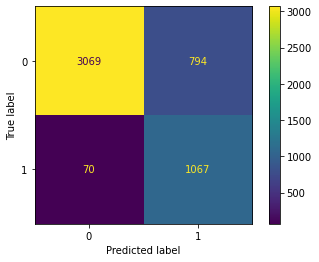

In [45]:
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay

X_pred=preprocessor.transform(X)

X_pred=feacture_selection(X_pred)
y_pred=gs.best_estimator_.predict(X_pred)
cm=confusion_matrix(y, y_pred)
cm = confusion_matrix(y, y_pred)
disp = ConfusionMatrixDisplay(confusion_matrix=cm,
                              )
disp.plot()

plt.show()

## test data 訓練

In [46]:

test=pd.read_csv("test_covid.csv")

"""
mean_hh_cli_ct                                            4784 non-null   float64
pct_worried_finances                                      0 non-null      float64
pct_cmnty_cli                                             4804 non-null   float64

"""
# test=test.drop(['date', 'state_code', 'gender', 'age_bucket',"mean_hh_cli_ct","pct_worried_finances","pct_cmnty_cli"],axis=1)

X_test=test.drop(["date","pct_worried_finances"],axis=1)
X_test=preprocessor.transform(X_test)
X_test=feacture_selection(X_test)
X_test.shape

(906, 22)

In [47]:
y_test=gs.best_estimator_.predict(X_test)
y_test=y_test.astype(np.int64)
col=['test_condition']
df=pd.DataFrame(y_test,columns=col)
df.to_csv('xgboost.csv', index = True,index_label='id') 


## Record Model Score

In [137]:
scores.update({"kaggle score":[]})
scores["kaggle score"].append(0.652)
df_scores = pd.DataFrame(scores,index)
print(df_scores)

                                       f1  f1_weighted accuracy  kaggle score
XGBClassifier+undersample+RFECV  0.734778              0.747584         0.652


In [138]:
Total_df_scores=pd.read_excel("實驗數據\不同模型分數.xlsx",index_col=0)
Total_df_scores=pd.concat([Total_df_scores,df_scores])
Total_df_scores.to_excel("實驗數據\不同模型分數.xlsx")

# GradientBoostingClassifier

## Make Pipeline

In [229]:
from sklearn.ensemble import GradientBoostingClassifier

num_pipe = make_pipeline_with_sampler(
    SimpleImputer(missing_values=np.nan, strategy='mean'),StandardScaler(), MinMaxScaler(feature_range=(1, 100))
    
)
cat_pipe = make_pipeline_with_sampler(
    SimpleImputer(missing_values=np.nan, strategy='most_frequent'),
    TargetEncoder()
)    
preprocessor = make_column_transformer(
    (cat_pipe, selector(dtype_exclude="number")),
    (num_pipe, selector(dtype_include="number")),
    
    
)
preparedata=make_pipeline_with_sampler(
    preprocessor,RandomUnderSampler(random_state=42)
)

X_pre=preprocessor.fit_transform(X,y)
rus = RandomUnderSampler(random_state=42)
X_res, y_res = rus.fit_resample(X_pre, y)
# sklearn.feature_selection.RFECV
X_sel=feacture_selection(X_res) #from RFECV 
y_sel=y_res

gradientBoostingClassifier=GradientBoostingClassifier(n_estimators=100, learning_rate=1.0,max_depth=4, random_state=0)
clf = make_pipeline_with_sampler(
    gradientBoostingClassifier
)
clf.get_params().keys()

dict_keys(['memory', 'steps', 'verbose', 'gradientboostingclassifier', 'gradientboostingclassifier__ccp_alpha', 'gradientboostingclassifier__criterion', 'gradientboostingclassifier__init', 'gradientboostingclassifier__learning_rate', 'gradientboostingclassifier__loss', 'gradientboostingclassifier__max_depth', 'gradientboostingclassifier__max_features', 'gradientboostingclassifier__max_leaf_nodes', 'gradientboostingclassifier__min_impurity_decrease', 'gradientboostingclassifier__min_impurity_split', 'gradientboostingclassifier__min_samples_leaf', 'gradientboostingclassifier__min_samples_split', 'gradientboostingclassifier__min_weight_fraction_leaf', 'gradientboostingclassifier__n_estimators', 'gradientboostingclassifier__n_iter_no_change', 'gradientboostingclassifier__random_state', 'gradientboostingclassifier__subsample', 'gradientboostingclassifier__tol', 'gradientboostingclassifier__validation_fraction', 'gradientboostingclassifier__verbose', 'gradientboostingclassifier__warm_start']

## Model Training

In [230]:
# from sklearn.model_selection import TimeSeriesSplit
param_grid = { 
    # "condensednearestneighbour__sampling_strategy":["all","not majority"],
    
    'gradientboostingclassifier__learning_rate': [0.05], 
    'gradientboostingclassifier__max_depth': [2,4,6], # 2,4,6中 6最好
    'gradientboostingclassifier__n_estimators': [1000], #1000,2000,3000,4000,5000中 5000最好 越多越好
    
    
}
# GridSearchCV : refit==True 會重新用整個data重新訓練一次
gs=GridSearchCV(estimator=clf,
               param_grid=param_grid,
               scoring={"f1": "f1", "f1_weighted accuracy": "f1_weighted"},
               refit="f1_weighted accuracy",
               return_train_score=True,
               cv=5,
            # cv=TimeSeriesSplit(),
               n_jobs = -1,
              )
gs=gs.fit(X_sel,y_res)

## Recodr Model Training Result

In [233]:
# print(gs.best_params_)

# df=pd.DataFrame(gs.cv_results_)
# gs.cv_results_.keys()

gs.cv_results_.keys()
print(gs.best_score_)
gs.best_estimator_

0.7569960144990843


Pipeline(steps=[('gradientboostingclassifier',
                 GradientBoostingClassifier(learning_rate=0.05, max_depth=6,
                                            n_estimators=1000,
                                            random_state=0))])

In [234]:
index=[]
index+= ["gradientboostingclassifier+undersample+RFECV"]
scores = {"f1": [], "f1_weighted accuracy": []}

scores["f1"].append(gs.cv_results_["mean_test_f1"].mean())
scores["f1_weighted accuracy"].append(gs.cv_results_["mean_test_f1_weighted accuracy"].mean())

df_scores = pd.DataFrame(scores,index)
print(df_scores)

                                                    f1  f1_weighted accuracy
gradientboostingclassifier+undersample+RFECV  0.744974              0.754427


## test data 訓練

In [235]:

test=pd.read_csv("test_covid.csv")

"""
mean_hh_cli_ct                                            4784 non-null   float64
pct_worried_finances                                      0 non-null      float64
pct_cmnty_cli                                             4804 non-null   float64

"""
# test=test.drop(['date', 'state_code', 'gender', 'age_bucket',"mean_hh_cli_ct","pct_worried_finances","pct_cmnty_cli"],axis=1)

X_test=test.drop(["date","pct_worried_finances"],axis=1)
X_test=preprocessor.transform(X_test)
X_test=feacture_selection(X_test)
X_test.shape

(906, 8)

In [240]:
y_test=gs.best_estimator_.predict(X_test)
y_test=y_test.astype(np.int64)
col=['test_condition']
df=pd.DataFrame(y_test,columns=col)
df.to_csv('gradientboostingclassifier.csv', index = True,index_label='id') 
y_test.dtype

dtype('int64')

## Record Model Score

In [241]:
scores.update({"kaggle score":[]})
scores["kaggle score"].append(0.66)
df_scores = pd.DataFrame(scores,index)
print(df_scores)

                                                    f1  f1_weighted accuracy  \
gradientboostingclassifier+undersample+RFECV  0.744974              0.754427   

                                              kaggle score  
gradientboostingclassifier+undersample+RFECV          0.66  


In [242]:
Total_df_scores=pd.read_excel("實驗數據\不同模型分數.xlsx",index_col=0)
Total_df_scores=pd.concat([Total_df_scores,df_scores])
Total_df_scores.to_excel("實驗數據\不同模型分數.xlsx")

# AdaBoost classifier

## Make Pipeline

In [220]:
from sklearn.ensemble import AdaBoostClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.svm import SVC
from sklearn.ensemble import VotingClassifier
num_pipe = make_pipeline_with_sampler(
    SimpleImputer(missing_values=np.nan, strategy='mean'),StandardScaler(), MinMaxScaler(feature_range=(1, 100))
    
)
cat_pipe = make_pipeline_with_sampler(
    SimpleImputer(missing_values=np.nan, strategy='most_frequent'),
    TargetEncoder()
)    
preprocessor = make_column_transformer(
    (cat_pipe, selector(dtype_exclude="number")),
    (num_pipe, selector(dtype_include="number")),
    (
    
)
preparedata=make_pipeline_with_sampler(
    preprocessor,RandomUnderSampler(random_state=42)
)

X_pre=preprocessor.fit_transform(X,y)
rus = RandomUnderSampler(random_state=42)
X_res, y_res = rus.fit_resample(X_pre, y)
# sklearn.feature_selection.RFECV
X_sel=feacture_selection(X_res) #from RFECV 
y_sel=y_res


clf1 = DecisionTreeClassifier(max_depth=4)
# clf2 = KNeighborsClassifier(n_neighbors=7)
# clf3 = SVC(gamma=0.1, kernel="rbf", probability=True)
clf = AdaBoostClassifier(n_estimators=500, random_state=0)#,base_estimator=clf1
clf = make_pipeline_with_sampler(
    clf
)
clf.get_params().keys()

dict_keys(['memory', 'steps', 'verbose', 'adaboostclassifier', 'adaboostclassifier__algorithm', 'adaboostclassifier__base_estimator', 'adaboostclassifier__learning_rate', 'adaboostclassifier__n_estimators', 'adaboostclassifier__random_state'])

## Model Training

In [219]:

# from sklearn.model_selection import TimeSeriesSplit
param_grid = { 
    # "condensednearestneighbour__sampling_strategy":["all","not majority"],
    "adaboostclassifier__base_estimator":[clf1],
    
    
}
# GridSearchCV : refit==True 會重新用整個data重新訓練一次
gs=GridSearchCV(estimator=clf,
               param_grid=param_grid,
               scoring={"f1": "f1", "f1_weighted accuracy": "f1_weighted"},
               refit="f1_weighted accuracy",
               return_train_score=True,
               cv=5,
            # cv=TimeSeriesSplit(),
               n_jobs = -1,
              )
gs=gs.fit(X_sel,y_res)

## Recodr Model Training Result

In [221]:
print(gs.best_params_)

df=pd.DataFrame(gs.cv_results_)
# gs.cv_results_.keys()
# gs.best_estimator_

print(gs.best_score_)
gs.cv_results_.keys()
df

{'adaboostclassifier__base_estimator': DecisionTreeClassifier(max_depth=4)}
0.7414987214907833


,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_adaboostclassifier__base_estimator,params,split0_test_f1,split1_test_f1,split2_test_f1,split3_test_f1,...,mean_test_f1_weighted accuracy,std_test_f1_weighted accuracy,rank_test_f1_weighted accuracy,split0_train_f1_weighted accuracy,split1_train_f1_weighted accuracy,split2_train_f1_weighted accuracy,split3_train_f1_weighted accuracy,split4_train_f1_weighted accuracy,mean_train_f1_weighted accuracy,std_train_f1_weighted accuracy
0,7.861861,0.055771,0.224861,0.003085,DecisionTreeClassifier(max_depth=4),{'adaboostclassifier__base_estimator': Decisio...,0.561039,0.75737,0.780992,0.790021,...,0.741499,0.061192,1,1.0,1.0,1.0,1.0,1.0,1.0,0.0


In [222]:
index=[]
index+= ["adaboostclassifier+undersample+RFECV"]
scores = {"f1": [], "f1_weighted accuracy": []}

scores["f1"].append(gs.cv_results_["mean_test_f1"].mean())
scores["f1_weighted accuracy"].append(gs.cv_results_["mean_test_f1_weighted accuracy"].mean())

df_scores = pd.DataFrame(scores,index)
print(df_scores)

                                            f1  f1_weighted accuracy
adaboostclassifier+undersample+RFECV  0.734025              0.741499


## test data 訓練

In [223]:

test=pd.read_csv("test_covid.csv")

"""
mean_hh_cli_ct                                            4784 non-null   float64
pct_worried_finances                                      0 non-null      float64
pct_cmnty_cli                                             4804 non-null   float64

"""
# test=test.drop(['date', 'state_code', 'gender', 'age_bucket',"mean_hh_cli_ct","pct_worried_finances","pct_cmnty_cli"],axis=1)

X_test=test.drop(["date","pct_worried_finances"],axis=1)
X_test=preprocessor.transform(X_test)
X_test=feacture_selection(X_test)
X_test.shape

(906, 8)

In [225]:
y_test=gs.best_estimator_.predict(X_test)
y_test=y_test.astype(np.int64)
col=['test_condition']
df=pd.DataFrame(y_test,columns=col)
df.to_csv('adaboostclassifier.csv', index = True,index_label='id') 


## Record Model Score

In [226]:
scores.update({"kaggle score":[]})
scores["kaggle score"].append(0.66)
df_scores = pd.DataFrame(scores,index)
print(df_scores)

                                            f1  f1_weighted accuracy  \
adaboostclassifier+undersample+RFECV  0.734025              0.741499   

                                      kaggle score  
adaboostclassifier+undersample+RFECV          0.66  


In [227]:
Total_df_scores=pd.read_excel("實驗數據\不同模型分數.xlsx",index_col=0)
Total_df_scores=pd.concat([Total_df_scores,df_scores])
Total_df_scores.to_excel("實驗數據\不同模型分數.xlsx")

# Bagging classifier

## Make Pipeline

In [246]:
from sklearn.ensemble import BaggingClassifier
from sklearn.svm import SVC
from sklearn.tree import DecisionTreeClassifier
num_pipe = make_pipeline_with_sampler(
    SimpleImputer(missing_values=np.nan, strategy='mean'),StandardScaler(), MinMaxScaler(feature_range=(1, 100))
    
)
cat_pipe = make_pipeline_with_sampler(
    SimpleImputer(missing_values=np.nan, strategy='most_frequent'),
    TargetEncoder()
)    
preprocessor = make_column_transformer(
    (cat_pipe, selector(dtype_exclude="number")),
    (num_pipe, selector(dtype_include="number")),
    
    
)
preparedata=make_pipeline_with_sampler(
    preprocessor,RandomUnderSampler(random_state=42)
)

X_pre=preprocessor.fit_transform(X,y)
rus = RandomUnderSampler(random_state=42)
X_res, y_res = rus.fit_resample(X_pre, y)
# sklearn.feature_selection.RFECV
X_sel=feacture_selection(X_res) #from RFECV 
y_sel=y_res

clf1 = DecisionTreeClassifier(max_depth=4)
clf3 = SVC(gamma=0.1, kernel="rbf", probability=True)
baggingClassifier=BaggingClassifier(n_estimators=100, random_state=0)
clf = make_pipeline_with_sampler(                       
    baggingClassifier
)
clf.get_params().keys()

dict_keys(['memory', 'steps', 'verbose', 'baggingclassifier', 'baggingclassifier__base_estimator', 'baggingclassifier__bootstrap', 'baggingclassifier__bootstrap_features', 'baggingclassifier__max_features', 'baggingclassifier__max_samples', 'baggingclassifier__n_estimators', 'baggingclassifier__n_jobs', 'baggingclassifier__oob_score', 'baggingclassifier__random_state', 'baggingclassifier__verbose', 'baggingclassifier__warm_start'])

## Model Training

In [248]:
# from sklearn.model_selection import TimeSeriesSplit
param_grid = { 
    # "condensednearestneighbour__sampling_strategy":["all","not majority"],
    
    "baggingclassifier__base_estimator":[clf1,clf3],

    'baggingclassifier__n_estimators': [1000], #1000,2000,3000,4000,5000中 5000最好 越多越好
    
    
}
# GridSearchCV : refit==True 會重新用整個data重新訓練一次
gs=GridSearchCV(estimator=clf,
               param_grid=param_grid,
               scoring={"f1": "f1", "f1_weighted accuracy": "f1_weighted"},
               refit="f1_weighted accuracy",
               return_train_score=True,
               cv=5,
            # cv=TimeSeriesSplit(),
               n_jobs = -1,
              )
gs=gs.fit(X_sel,y_res)

## Recodr Model Training Result

In [251]:
# print(gs.best_params_)

# df=pd.DataFrame(gs.cv_results_)
# gs.cv_results_.keys()

# gs.cv_results_.keys()
print(gs.best_score_)
gs.best_estimator_

0.75132277052777


Pipeline(steps=[('baggingclassifier',
                 BaggingClassifier(base_estimator=DecisionTreeClassifier(max_depth=4),
                                   n_estimators=1000, random_state=0))])

In [252]:
index=[]
index+= ["BaggingClassifier+undersample+RFECV"]
scores = {"f1": [], "f1_weighted accuracy": []}

scores["f1"].append(gs.cv_results_["mean_test_f1"].mean())
scores["f1_weighted accuracy"].append(gs.cv_results_["mean_test_f1_weighted accuracy"].mean())

df_scores = pd.DataFrame(scores,index)
print(df_scores)

                                           f1  f1_weighted accuracy
BaggingClassifier+undersample+RFECV  0.597956              0.570449


## test data 訓練

In [253]:

test=pd.read_csv("test_covid.csv")

"""
mean_hh_cli_ct                                            4784 non-null   float64
pct_worried_finances                                      0 non-null      float64
pct_cmnty_cli                                             4804 non-null   float64

"""
# test=test.drop(['date', 'state_code', 'gender', 'age_bucket',"mean_hh_cli_ct","pct_worried_finances","pct_cmnty_cli"],axis=1)

X_test=test.drop(["date","pct_worried_finances"],axis=1)
X_test=preprocessor.transform(X_test)
X_test=feacture_selection(X_test)
X_test.shape

(906, 8)

In [255]:
y_test=gs.best_estimator_.predict(X_test)
y_test=y_test.astype(np.int64)
col=['test_condition']
df=pd.DataFrame(y_test,columns=col)
df.to_csv('BaggingClassifier.csv', index = True,index_label='id') 


## Record Model Score

In [256]:
scores.update({"kaggle score":[]})
scores["kaggle score"].append(0.63)
df_scores = pd.DataFrame(scores,index)
print(df_scores)

                                           f1  f1_weighted accuracy  \
BaggingClassifier+undersample+RFECV  0.597956              0.570449   

                                     kaggle score  
BaggingClassifier+undersample+RFECV          0.63  


In [257]:
Total_df_scores=pd.read_excel("實驗數據\不同模型分數.xlsx",index_col=0)
Total_df_scores=pd.concat([Total_df_scores,df_scores])
Total_df_scores.to_excel("實驗數據\不同模型分數.xlsx")

# LGBMClassifier

## Make Pipeline

In [ ]:
num_pipe = make_pipeline_with_sampler(
    SimpleImputer(missing_values=np.nan, strategy='mean'),StandardScaler(), MinMaxScaler(feature_range=(1, 100))
    
)
cat_pipe = make_pipeline_with_sampler(
    SimpleImputer(missing_values=np.nan, strategy='most_frequent'),
    TargetEncoder()
)    
preprocessor = make_column_transformer(
    (cat_pipe, selector(dtype_exclude="number")),
    (num_pipe, selector(dtype_include="number")),
    
)
preparedata=make_pipeline_with_sampler(
    preprocessor,RandomUnderSampler(random_state=42)
)

X_pre=preprocessor.fit_transform(X,y)
rus = RandomUnderSampler(random_state=42)
X_res, y_res = rus.fit_resample(X_pre, y)
# sklearn.feature_selection.RFECV
X_sel=feacture_selection(X_res) #from RFECV 
y_sel=y_res

XGBClassifier= xgb.XGBClassifier(objective= 'binary:logistic',eval_metric='mlogloss',
    tree_method="gpu_hist",enable_categorical=True, use_label_encoder=False,
    seed=42,learning_rate=0.05,max_depth=6,min_child_weight=11,subsample=0.8,colsample_bytree=0.7,n_estimators=1000,gamma=0.2)
clf = make_pipeline_with_sampler(
    XGBClassifier
)
clf.get_params().keys()

dict_keys(['memory', 'steps', 'verbose', 'xgbclassifier', 'xgbclassifier__objective', 'xgbclassifier__use_label_encoder', 'xgbclassifier__base_score', 'xgbclassifier__booster', 'xgbclassifier__colsample_bylevel', 'xgbclassifier__colsample_bynode', 'xgbclassifier__colsample_bytree', 'xgbclassifier__enable_categorical', 'xgbclassifier__gamma', 'xgbclassifier__gpu_id', 'xgbclassifier__importance_type', 'xgbclassifier__interaction_constraints', 'xgbclassifier__learning_rate', 'xgbclassifier__max_delta_step', 'xgbclassifier__max_depth', 'xgbclassifier__min_child_weight', 'xgbclassifier__missing', 'xgbclassifier__monotone_constraints', 'xgbclassifier__n_estimators', 'xgbclassifier__n_jobs', 'xgbclassifier__num_parallel_tree', 'xgbclassifier__predictor', 'xgbclassifier__random_state', 'xgbclassifier__reg_alpha', 'xgbclassifier__reg_lambda', 'xgbclassifier__scale_pos_weight', 'xgbclassifier__subsample', 'xgbclassifier__tree_method', 'xgbclassifier__validate_parameters', 'xgbclassifier__verbosi

## Model Training

In [ ]:
# from sklearn.model_selection import TimeSeriesSplit
param_grid = { 
    # "condensednearestneighbour__sampling_strategy":["all","not majority"],
    
    'xgbclassifier__learning_rate': [0.05], 
    'xgbclassifier__max_depth': [6], # 2,4,6中 6最好
    'xgbclassifier__min_child_weight': [11],# 11,20,30中 11最好
    
    'xgbclassifier__subsample': [0.8],#0.4,0.8中 0.8最好
    'xgbclassifier__colsample_bytree': [0.7],
    'xgbclassifier__n_estimators': [1000], #1000,2000,3000,4000,5000中 5000最好 越多越好
    "xgbclassifier__gamma":[0.2] # 0.1,0.2,0.3中 0.2最好
    
}
# GridSearchCV : refit==True 會重新用整個data重新訓練一次
gs=GridSearchCV(estimator=clf,
               param_grid=param_grid,
               scoring={"f1": "f1", "f1_weighted accuracy": "f1_weighted"},
               refit="f1_weighted accuracy",
               return_train_score=True,
               cv=5,
            # cv=TimeSeriesSplit(),
               n_jobs = -1,
              )
gs=gs.fit(X_sel,y_res)

## Recodr Model Training Result

In [ ]:
# print(gs.best_params_)

# df=pd.DataFrame(gs.cv_results_)
# gs.cv_results_.keys()
# gs.best_estimator_
# gs.cv_results_.keys()
print(gs.best_score_)


0.7617620663905265


In [ ]:
index=[]
index+= ["XGBClassifier+undersample+RFECV"]
scores = {"f1": [], "f1_weighted accuracy": []}

scores["f1"].append(gs.cv_results_["mean_test_f1"].mean())
scores["f1_weighted accuracy"].append(gs.cv_results_["mean_test_f1_weighted accuracy"].mean())

df_scores = pd.DataFrame(scores,index)
print(df_scores)

                                       f1  f1_weighted accuracy
XGBClassifier+undersample+RFECV  0.755861              0.761762


## test data 訓練

In [ ]:

test=pd.read_csv("test_covid.csv")

"""
mean_hh_cli_ct                                            4784 non-null   float64
pct_worried_finances                                      0 non-null      float64
pct_cmnty_cli                                             4804 non-null   float64

"""
# test=test.drop(['date', 'state_code', 'gender', 'age_bucket',"mean_hh_cli_ct","pct_worried_finances","pct_cmnty_cli"],axis=1)

X_test=test.drop(["date","pct_worried_finances"],axis=1)
X_test=preprocessor.transform(X_test)
X_test=feacture_selection(X_test)
X_test.shape

(906, 8)

In [ ]:
y_test=gs.best_estimator_.predict(X_test)

col=['test_condition']
df=pd.DataFrame(y_test,columns=col)
df.to_csv('xgboost.csv', index = True,index_label='id') 


## Record Model Score

In [ ]:
scores.update({"kaggle score":[]})
scores["kaggle score"].append(0.652)
df_scores = pd.DataFrame(scores,index)
print(df_scores)

                                       f1  f1_weighted accuracy  kaggle score
XGBClassifier+undersample+RFECV  0.755861              0.761762         0.652


In [ ]:
Total_df_scores=pd.read_excel("實驗數據\不同模型分數.xlsx",index_col=0)
Total_df_scores=pd.concat([Total_df_scores,df_scores])
Total_df_scores.to_excel("實驗數據\不同模型分數.xlsx")

# CatBoostClassifier

In [164]:
from catboost import CatBoostClassifier
import numpy as np
import ipywidgets

## Make Pipeline

In [165]:
num_pipe = make_pipeline_with_sampler(
    SimpleImputer(missing_values=np.nan, strategy='mean'),StandardScaler(), MinMaxScaler(feature_range=(1, 100))
    
)
cat_pipe = make_pipeline_with_sampler(
    SimpleImputer(missing_values=np.nan, strategy='most_frequent'),
    TargetEncoder()
)    
preprocessor = make_column_transformer(
    (cat_pipe, selector(dtype_exclude="number")),
    (num_pipe, selector(dtype_include="number")),
    
    
)
preparedata=make_pipeline_with_sampler(
    preprocessor,RandomUnderSampler(random_state=42)
)

X_pre=preprocessor.fit_transform(X,y)
rus = RandomUnderSampler(random_state=42)
X_res, y_res = rus.fit_resample(X_pre, y)
# sklearn.feature_selection.RFECV
X_sel=feacture_selection(X_res) #from RFECV 
y_sel=y_res


catBoostClassifier = CatBoostClassifier(loss_function='Logloss')

# grid = {'learning_rate': [0.03, 0.1],
#         'depth': [4, 6, 10],
#         'l2_leaf_reg': [1, 3, 5, 7, 9]}

# grid_search_result = catBoostClassifier.grid_search(grid,
#                                        X=X_sel,
#                                        y=y_res,
#                                        plot=True)

Custom logger is already specified. Specify more than one logger at same time is not thread safe.

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.6816344	test: 0.6820753	best: 0.6820753 (0)	total: 146ms	remaining: 2m 25s
1:	learn: 0.6725120	test: 0.6729120	best: 0.6729120 (1)	total: 148ms	remaining: 1m 13s
2:	learn: 0.6629180	test: 0.6647585	best: 0.6647585 (2)	total: 149ms	remaining: 49.6s
3:	learn: 0.6546002	test: 0.6565976	best: 0.6565976 (3)	total: 150ms	remaining: 37.5s
4:	learn: 0.6455478	test: 0.6486291	best: 0.6486291 (4)	total: 151ms	remaining: 30.1s
5:	learn: 0.6376219	test: 0.6409875	best: 0.6409875 (5)	total: 153ms	remaining: 25.3s
6:	learn: 0.6299697	test: 0.6336258	best: 0.6336258 (6)	total: 154ms	remaining: 21.8s
7:	learn: 0.6212495	test: 0.6256236	best: 0.6256236 (7)	total: 155ms	remaining: 19.2s
8:	learn: 0.6136463	test: 0.6182718	best: 0.6182718 (8)	total: 156ms	remaining: 17.2s
9:	learn: 0.6063995	test: 0.6121421	best: 0.6121421 (9)	total: 157ms	remaining: 15.5s
10:	learn: 0.6003911	test: 0.6061208	best: 0.6061208 (10)	total: 158ms	remaining: 14.2s
11:	learn: 0.5937819	test: 0.5997810	best: 0.59978

## Model Training

In [183]:
grid_search_result["params"]

{'depth': 6, 'l2_leaf_reg': 3, 'learning_rate': 0.1}

In [186]:


catBoostClassifier = CatBoostClassifier(depth=6,loss_function='Logloss',l2_leaf_reg=3,learning_rate=0.1,eval_metric='TotalF1')
catBoostClassifier.fit(X_sel, y_sel)
# gs=gs.fit(X_sel,y_res)

0:	learn: 0.7530598	total: 3.24ms	remaining: 3.23s
1:	learn: 0.7625212	total: 6.72ms	remaining: 3.35s
2:	learn: 0.7638500	total: 9.78ms	remaining: 3.25s
3:	learn: 0.7779054	total: 12ms	remaining: 2.98s
4:	learn: 0.7827615	total: 14.4ms	remaining: 2.86s
5:	learn: 0.7849604	total: 16.6ms	remaining: 2.75s
6:	learn: 0.7840799	total: 18.9ms	remaining: 2.68s
7:	learn: 0.7901933	total: 22.7ms	remaining: 2.82s
8:	learn: 0.7937411	total: 27.2ms	remaining: 3s
9:	learn: 0.7985889	total: 30.6ms	remaining: 3.03s
10:	learn: 0.7990154	total: 33.1ms	remaining: 2.98s
11:	learn: 0.8020955	total: 36.2ms	remaining: 2.98s
12:	learn: 0.8047397	total: 39.7ms	remaining: 3.01s
13:	learn: 0.8073806	total: 42.1ms	remaining: 2.96s
14:	learn: 0.8091445	total: 44.7ms	remaining: 2.94s
15:	learn: 0.8095863	total: 47.2ms	remaining: 2.9s
16:	learn: 0.8113456	total: 49.9ms	remaining: 2.88s
17:	learn: 0.8122251	total: 53.2ms	remaining: 2.9s
18:	learn: 0.8126636	total: 55.6ms	remaining: 2.87s
19:	learn: 0.8122242	total: 5

In [189]:
catBoostClassifier.best_score_["learn"]["TotalF1"]

1.0

## Recodr Model Training Result

In [190]:
index=[]
index+= ["CatBoostClassifier+undersample+RFECV"]
scores = {"f1": [], "f1_weighted accuracy": []}

scores["f1"].append(catBoostClassifier.best_score_["learn"]["TotalF1"])
scores["f1_weighted accuracy"].append("NG")

df_scores = pd.DataFrame(scores,index)
print(df_scores)

                                       f1 f1_weighted accuracy
CatBoostClassifier+undersample+RFECV  1.0                   NG


## test data 訓練

In [191]:

test=pd.read_csv("test_covid.csv")

"""
mean_hh_cli_ct                                            4784 non-null   float64
pct_worried_finances                                      0 non-null      float64
pct_cmnty_cli                                             4804 non-null   float64

"""
# test=test.drop(['date', 'state_code', 'gender', 'age_bucket',"mean_hh_cli_ct","pct_worried_finances","pct_cmnty_cli"],axis=1)

X_test=test.drop(["date","pct_worried_finances"],axis=1)
X_test=preprocessor.transform(X_test)
X_test=feacture_selection(X_test)
X_test.shape

(906, 8)

In [201]:

y_test = catBoostClassifier.predict(X_test)
y_test=y_test.astype(np.int64)
print(y_test.dtype)
col=['test_condition']
df=pd.DataFrame(y_test,columns=col)
df.to_csv('catBoostClassifier.csv', index = True,index_label='id') 


int64


## Record Model Score

In [202]:
scores.update({"kaggle score":[]})
scores["kaggle score"].append(0.644)
df_scores = pd.DataFrame(scores,index)
print(df_scores)

                                       f1 f1_weighted accuracy  kaggle score
CatBoostClassifier+undersample+RFECV  1.0                   NG         0.644


In [203]:
Total_df_scores=pd.read_excel("實驗數據\不同模型分數.xlsx",index_col=0)
Total_df_scores=pd.concat([Total_df_scores,df_scores])
Total_df_scores.to_excel("實驗數據\不同模型分數.xlsx")

# VotingClassifier

In [7]:
from catboost import CatBoostClassifier
import ipywidgets
from sklearn.ensemble import RandomForestClassifier, VotingClassifier
import xgboost as xgb
from sklearn.ensemble import AdaBoostClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import BaggingClassifier
from sklearn.svm import SVC
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.feature_selection import VarianceThreshold
from sklearn.feature_selection import SelectKBest, chi2
from imblearn.combine import SMOTEENN, SMOTETomek

## Make Pipeline

In [10]:
num_pipe = make_pipeline_with_sampler(
    SimpleImputer(missing_values=np.nan, strategy='mean'),StandardScaler()
    # , MinMaxScaler(feature_range=(1, 100))
    
)
cat_pipe = make_pipeline_with_sampler(
    SimpleImputer(missing_values=np.nan, strategy='most_frequent'),
    TargetEncoder()
)    
preprocessor = make_column_transformer(
    (cat_pipe, selector(dtype_exclude="number")),
    (num_pipe, selector(dtype_include="number")),
    
    
)

# preparedata=make_pipeline_with_sampler(
#     preprocessor,RandomUnderSampler(random_state=42)
# )

X_sel=preprocessor.fit_transform(X,y)
rus = RandomUnderSampler(random_state=42)#SMOTETomek(random_state=42)
X_res, y_res = rus.fit_resample(X_pre, y)

# VarianceThreshold = VarianceThreshold()
# X_sel=VarianceThreshold.fit_transform(X_res)
# X_sel = SelectKBest(chi2, k=50).fit_transform(X_sel, y_res)
# X_sel=preprare.fit_transform(X_res,y_res)

# sklearn.feature_selection.RFECV

X_sel=feacture_selection(X_res) #from RFECV 

# X_sel=X_res #不使用RFECV
y_sel=y_res
random_seed=42

clf1=xgb.XGBClassifier(base_score=0.5, booster='gbtree',
                               colsample_bylevel=1, colsample_bynode=1,
                               colsample_bytree=0.7, enable_categorical=True,
                               eval_metric='mlogloss', gamma=0.2, gpu_id=0,
                               importance_type=None, interaction_constraints='',
                               learning_rate=0.05, max_delta_step=0,
                               max_depth=6, min_child_weight=25,
                               monotone_constraints='()', n_estimators=1000,
                               n_jobs=8, num_parallel_tree=1, predictor='auto',
                               random_state=42, reg_alpha=0, reg_lambda=1,
                               scale_pos_weight=1, seed=42, subsample=0.8,
                               tree_method='gpu_hist', use_label_encoder=False,
                               validate_parameters=1)
clf2=GradientBoostingClassifier(learning_rate=0.05, max_depth=6,
                                            n_estimators=1000,
                                            random_state=random_seed,max_features="sqrt",n_iter_no_change=5)
                                            #n_iter_no_change 防止overfitting
clf3=AdaBoostClassifier(base_estimator=DecisionTreeClassifier(max_depth=6),n_estimators=1000, random_state=random_seed)
clf4=BaggingClassifier(base_estimator=DecisionTreeClassifier(max_depth=6),
                                   n_estimators=1000, random_state=random_seed)
# clf6 = CatBoostClassifier(depth=6,loss_function='Logloss',l2_leaf_reg=3,learning_rate=0.1,eval_metric='TotalF1')
eclf2 = VotingClassifier(estimators=[
        ('XGBClassifier', clf1), ('GradientBoostingClassifier', clf2), ('AdaBoostClassifier', clf3),
        # ('BaggingClassifier', clf4)
        # ,('CatBoostClassifier', clf6)
        ],
        voting='soft')
clf = make_pipeline_with_sampler(
    eclf2
)
clf.get_params().keys()
# X_sel.shape

dict_keys(['memory', 'steps', 'verbose', 'votingclassifier', 'votingclassifier__estimators', 'votingclassifier__flatten_transform', 'votingclassifier__n_jobs', 'votingclassifier__verbose', 'votingclassifier__voting', 'votingclassifier__weights', 'votingclassifier__XGBClassifier', 'votingclassifier__GradientBoostingClassifier', 'votingclassifier__AdaBoostClassifier', 'votingclassifier__XGBClassifier__objective', 'votingclassifier__XGBClassifier__use_label_encoder', 'votingclassifier__XGBClassifier__base_score', 'votingclassifier__XGBClassifier__booster', 'votingclassifier__XGBClassifier__colsample_bylevel', 'votingclassifier__XGBClassifier__colsample_bynode', 'votingclassifier__XGBClassifier__colsample_bytree', 'votingclassifier__XGBClassifier__enable_categorical', 'votingclassifier__XGBClassifier__gamma', 'votingclassifier__XGBClassifier__gpu_id', 'votingclassifier__XGBClassifier__importance_type', 'votingclassifier__XGBClassifier__interaction_constraints', 'votingclassifier__XGBClassi

## Model Training

In [14]:
# from sklearn.model_selection import TimeSeriesSplit
param_grid = { 
   #   'votingclassifier__XGBClassifier__n_estimators':[10,20,30,40],
   #   "votingclassifier__AdaBoostClassifier__n_estimators":[10,20,30,40],
     
}
# GridSearchCV : refit==True 會重新用整個data重新訓練一次
gs=GridSearchCV(estimator=clf,
               param_grid=param_grid,
               scoring={"f1": "f1", "f1_weighted accuracy": "f1_weighted"},
               refit="f1_weighted accuracy",
               return_train_score=True,
               cv=5,
            # cv=TimeSeriesSplit(),
               n_jobs = -1,
              )
gs=gs.fit(X_sel,y_sel)

## Recodr Model Training Result

In [15]:
# print(gs.best_params_)

df=pd.DataFrame(gs.cv_results_)
# gs.cv_results_.keys()
# gs.best_estimator_
# gs.cv_results_.keys()
print(gs.best_score_)
gs.best_estimator_
df

0.7012686780236044


,mean_fit_time,std_fit_time,mean_score_time,std_score_time,params,split0_test_f1,split1_test_f1,split2_test_f1,split3_test_f1,split4_test_f1,...,mean_test_f1_weighted accuracy,std_test_f1_weighted accuracy,rank_test_f1_weighted accuracy,split0_train_f1_weighted accuracy,split1_train_f1_weighted accuracy,split2_train_f1_weighted accuracy,split3_train_f1_weighted accuracy,split4_train_f1_weighted accuracy,mean_train_f1_weighted accuracy,std_train_f1_weighted accuracy
0,35.077634,0.325596,0.826097,0.110549,{},0.592233,0.719828,0.74739,0.713693,0.732143,...,0.701269,0.039616,1,0.992853,0.995602,0.993403,0.991754,0.995055,0.993733,0.001417


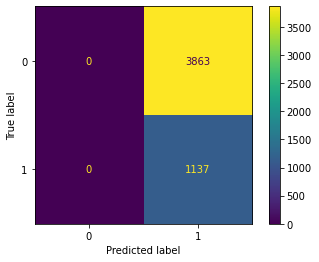

In [16]:

from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay

X_pred=preprocessor.transform(X)

X_pred=feacture_selection(X_pred)
y_pred=gs.best_estimator_.predict(X_pred)
cm=confusion_matrix(y, y_pred)
cm = confusion_matrix(y, y_pred)
disp = ConfusionMatrixDisplay(confusion_matrix=cm,
                              )
disp.plot()

plt.show()

In [121]:
X_pred.shape

(5000, 22)

In [122]:
index=[]
index+= ["votingclassifier+SMOTETomek+RFECV"]
scores = {"f1": [], "f1_weighted accuracy": []}

scores["f1"].append(gs.cv_results_["mean_test_f1"].mean())
scores["f1_weighted accuracy"].append(gs.cv_results_["mean_test_f1_weighted accuracy"].mean())

df_scores = pd.DataFrame(scores,index)
print(df_scores)
df_scores

                                         f1  f1_weighted accuracy
votingclassifier+SMOTETomek+RFECV  0.853523              0.843998


,f1,f1_weighted accuracy
votingclassifier+SMOTETomek+RFECV,0.853523,0.843998


## test data 訓練

In [123]:

test=pd.read_csv("test_covid.csv")

"""
mean_hh_cli_ct                                            4784 non-null   float64
pct_worried_finances                                      0 non-null      float64
pct_cmnty_cli                                             4804 non-null   float64

"""
# test=test.drop(['date', 'state_code', 'gender', 'age_bucket',"mean_hh_cli_ct","pct_worried_finances","pct_cmnty_cli"],axis=1)

X_test=test.drop(["date","pct_worried_finances"],axis=1)
X_test=preprocessor.transform(X_test)
# X_test=preprare.transform(X_test)
X_test=feacture_selection(X_test)
X_test.shape

(906, 22)

In [125]:
y_test=gs.best_estimator_.predict(X_test)
y_test=y_test.astype(np.int64)
col=['test_condition']
df=pd.DataFrame(y_test,columns=col)
df.to_csv('votingclassifier.csv', index = True,index_label='id') 


## Record Model Score

In [99]:
scores.update({"kaggle score":[]})
scores["kaggle score"].append(0.664)
df_scores = pd.DataFrame(scores,index)
print(df_scores)

                                         f1  f1_weighted accuracy  \
votingclassifier+SMOTETomek+RFECV  0.831107              0.823731   

                                   kaggle score  
votingclassifier+SMOTETomek+RFECV         0.664  


In [100]:
Total_df_scores=pd.read_excel("實驗數據\不同模型分數.xlsx",index_col=0)
Total_df_scores=pd.concat([Total_df_scores,df_scores])
Total_df_scores.to_excel("實驗數據\不同模型分數.xlsx")

# StackingClassifier

In [24]:
from catboost import CatBoostClassifier
import ipywidgets
# from sklearn.ensemble import RandomForestClassifier, VotingClassifier
import xgboost as xgb
from sklearn.ensemble import AdaBoostClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import BaggingClassifier
from sklearn.svm import SVC
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.ensemble import StackingClassifier
from imblearn.combine import SMOTEENN 
from sklearn.linear_model import LogisticRegression

## Make Pipeline

In [51]:

num_pipe = make_pipeline_with_sampler(
    SimpleImputer(missing_values=np.nan, strategy='mean'),StandardScaler(), MinMaxScaler(feature_range=(1, 100))
    
)
cat_pipe = make_pipeline_with_sampler(
    SimpleImputer(missing_values=np.nan, strategy='mean'),
    TargetEncoder()
)    
preprocessor = make_column_transformer(
    (num_pipe, selector(dtype_include="number")),
    (cat_pipe, selector(dtype_include="category")),
    
)
preparedata=make_pipeline_with_sampler(
    preprocessor,SMOTEENN(random_state=42)
)

X_pre=preprocessor.fit_transform(X,y)
rus = SMOTEENN(random_state=42)
X_res, y_res = rus.fit_resample(X_pre, y)
# sklearn.feature_selection.RFECV
X_sel=feacture_selection(X_res) #from RFECV 
# X_sel=X_res
y_sel=y_res

clf1=xgb.XGBClassifier(objective= 'binary:logistic',eval_metric='mlogloss',
    tree_method="gpu_hist",enable_categorical=True, use_label_encoder=False,
    seed=42,learning_rate=0.05,max_depth=6,min_child_weight=11,subsample=0.8,colsample_bytree=0.7,n_estimators=500,gamma=0.2)

clf2=GradientBoostingClassifier(learning_rate=0.05, max_depth=6,
                                            n_estimators=100,
                                            random_state=0)
clf3 = AdaBoostClassifier(base_estimator=DecisionTreeClassifier(max_depth=4),n_estimators=500, random_state=0)
clf4 =BaggingClassifier(base_estimator=DecisionTreeClassifier(max_depth=4),
                                   n_estimators=500, random_state=0)
clf6 = CatBoostClassifier(depth=6,loss_function='Logloss',l2_leaf_reg=3,learning_rate=0.1,eval_metric='TotalF1')
eclf2 = StackingClassifier(estimators=[
        ('XGBClassifier', clf1), ('GradientBoostingClassifier', clf2), ('AdaBoostClassifier', clf3),('BaggingClassifier', clf4),('CatBoostClassifier', clf6)],
        final_estimator=LogisticRegression())
clf = make_pipeline_with_sampler(
    eclf2
)
clf.get_params().keys()

dict_keys(['memory', 'steps', 'verbose', 'stackingclassifier', 'stackingclassifier__cv', 'stackingclassifier__estimators', 'stackingclassifier__final_estimator__C', 'stackingclassifier__final_estimator__class_weight', 'stackingclassifier__final_estimator__dual', 'stackingclassifier__final_estimator__fit_intercept', 'stackingclassifier__final_estimator__intercept_scaling', 'stackingclassifier__final_estimator__l1_ratio', 'stackingclassifier__final_estimator__max_iter', 'stackingclassifier__final_estimator__multi_class', 'stackingclassifier__final_estimator__n_jobs', 'stackingclassifier__final_estimator__penalty', 'stackingclassifier__final_estimator__random_state', 'stackingclassifier__final_estimator__solver', 'stackingclassifier__final_estimator__tol', 'stackingclassifier__final_estimator__verbose', 'stackingclassifier__final_estimator__warm_start', 'stackingclassifier__final_estimator', 'stackingclassifier__n_jobs', 'stackingclassifier__passthrough', 'stackingclassifier__stack_method

## Model Training

In [41]:
# from sklearn.model_selection import TimeSeriesSplit
param_grid = { 
    # "condensednearestneighbour__sampling_strategy":["all","not majority"],
    
    
}
# GridSearchCV : refit==True 會重新用整個data重新訓練一次
gs=GridSearchCV(estimator=clf,
               param_grid=param_grid,
               scoring={"f1": "f1", "f1_weighted accuracy": "f1_weighted","accuracy": "accuracy","balanced_accuracy": "balanced_accuracy"},
               refit="f1_weighted accuracy",
               return_train_score=True,
               cv=5,
            # cv=TimeSeriesSplit(),
               n_jobs = -1,
              )
gs=gs.fit(X_sel,y_res)

0:	learn: 0.8313896	total: 3.94ms	remaining: 3.93s
1:	learn: 0.8586390	total: 9.28ms	remaining: 4.63s
2:	learn: 0.8649689	total: 13.7ms	remaining: 4.54s
3:	learn: 0.8656861	total: 17.4ms	remaining: 4.33s
4:	learn: 0.8722030	total: 20.4ms	remaining: 4.06s
5:	learn: 0.8735519	total: 25.1ms	remaining: 4.16s
6:	learn: 0.8735387	total: 28.7ms	remaining: 4.07s
7:	learn: 0.8772721	total: 32.8ms	remaining: 4.07s
8:	learn: 0.8816870	total: 36.6ms	remaining: 4.03s
9:	learn: 0.8807215	total: 42.2ms	remaining: 4.18s
10:	learn: 0.8813789	total: 46.3ms	remaining: 4.16s
11:	learn: 0.8828078	total: 50.3ms	remaining: 4.14s
12:	learn: 0.8846513	total: 56.1ms	remaining: 4.26s
13:	learn: 0.8869808	total: 60.3ms	remaining: 4.25s
14:	learn: 0.8862614	total: 64.5ms	remaining: 4.24s
15:	learn: 0.8889321	total: 70.2ms	remaining: 4.31s
16:	learn: 0.8905635	total: 74.6ms	remaining: 4.31s
17:	learn: 0.8908945	total: 78.8ms	remaining: 4.3s
18:	learn: 0.8919667	total: 82.5ms	remaining: 4.26s
19:	learn: 0.8930496	to

## Recodr Model Training Result

In [64]:
# print(gs.best_params_)

# df=pd.DataFrame(gs.cv_results_)
# gs.cv_results_.keys()
# gs.best_estimator_
# gs.cv_results_.keys()
print(gs.best_score_)
gs.best_estimator_
df=pd.DataFrame(gs.cv_results_)
df


0.45237057615459


,mean_fit_time,std_fit_time,mean_score_time,std_score_time,params,split0_test_f1,split1_test_f1,split2_test_f1,split3_test_f1,split4_test_f1,...,mean_test_f1_weighted accuracy,std_test_f1_weighted accuracy,rank_test_f1_weighted accuracy,split0_train_f1_weighted accuracy,split1_train_f1_weighted accuracy,split2_train_f1_weighted accuracy,split3_train_f1_weighted accuracy,split4_train_f1_weighted accuracy,mean_train_f1_weighted accuracy,std_train_f1_weighted accuracy
0,0.398733,0.020991,0.228398,0.013185,{},0.670695,0.675799,0.684049,0.709677,0.688372,...,0.452371,0.051555,1,1.0,1.0,1.0,1.0,1.0,1.0,0.0


In [44]:
index=[]
index+= ["stackingclassifier+SMOTEENN+RFECV"]
scores = {"f1": [], "f1_weighted accuracy": []}

scores["f1"].append(gs.cv_results_["mean_test_f1"].mean())
scores["f1_weighted accuracy"].append(gs.cv_results_["mean_test_f1_weighted accuracy"].mean())

df_scores = pd.DataFrame(scores,index)
print(df_scores)

                                         f1  f1_weighted accuracy
stackingclassifier+SMOTEENN+RFECV  0.931233              0.910464


## test data 訓練

In [45]:

test=pd.read_csv("test_covid.csv")

"""
mean_hh_cli_ct                                            4784 non-null   float64
pct_worried_finances                                      0 non-null      float64
pct_cmnty_cli                                             4804 non-null   float64

"""
# test=test.drop(['date', 'state_code', 'gender', 'age_bucket',"mean_hh_cli_ct","pct_worried_finances","pct_cmnty_cli"],axis=1)

X_test=test.drop(["date","pct_worried_finances"],axis=1)
X_test=preprocessor.transform(X_test)
X_test=feacture_selection(X_test)
# X_test.shape

In [46]:
y_test=gs.best_estimator_.predict(X_test)
y_test=y_test.astype(np.int64)
col=['test_condition']
df=pd.DataFrame(y_test,columns=col)
df.to_csv('stackingclassifier.csv', index = True,index_label='id') 


## Record Model Score

In [49]:
scores.update({"kaggle score":[]})
scores["kaggle score"].append(0.66225)
df_scores = pd.DataFrame(scores,index)
print(df_scores)

                                         f1  f1_weighted accuracy  \
stackingclassifier+SMOTEENN+RFECV  0.931233              0.910464   

                                   kaggle score  
stackingclassifier+SMOTEENN+RFECV       0.66225  


In [50]:
Total_df_scores=pd.read_excel("實驗數據\不同模型分數.xlsx",index_col=0)
Total_df_scores=pd.concat([Total_df_scores,df_scores])
Total_df_scores.to_excel("實驗數據\不同模型分數.xlsx")

# 個別細節(其實不用這麼麻煩QQ)

## Use SimpleImputer 將nan用中位數替換

In [19]:
from sklearn.impute import SimpleImputer
imp_mean = SimpleImputer(missing_values=np.nan, strategy='mean')
#因為前三個欄位為str的type
X_num=X.iloc[:,3:]
#去掉不是float的feature
X_num=imp_mean.fit_transform(X_num)

X.iloc[:,3:]=X_num
#確認是否nan都替換掉
X.isna().sum().sum()
X

,state_code,gender,age_bucket,n,weight_sums,pct_cli,pct_ili,pct_cli_anosmia_ageusia,pct_hh_cli,pct_cmnty_cli,...,pct_diabetes_weighted,pct_cancer_weighted,pct_heart_disease_weighted,pct_high_blood_pressure_weighted,pct_asthma_weighted,pct_chronic_lung_disease_weighted,pct_kidney_disease_weighted,pct_autoimmune_disorder_weighted,pct_no_above_medical_conditions_weighted,pct_multiple_medical_conditions_weighted
0,az,female,35-54,691.0,7.178188e+05,1.9432,2.0927,3.7369,3.0435,16.353709,...,6.9885,4.8782,2.8226,20.9894,18.2209,3.6390,1.2656,12.4720,53.3755,16.5559
1,fl,female,35-54,594.0,2.440767e+06,1.1945,1.0239,2.5597,1.6835,16.353709,...,8.9227,3.5595,4.5854,22.2428,15.5840,3.6722,2.5126,11.2069,56.8991,17.8140
2,ia,male,55+,98.0,3.051519e+05,0.0000,0.0000,3.1915,1.0204,16.353709,...,20.2359,8.3652,17.2087,63.3270,8.4448,7.6395,11.3939,4.4325,19.2190,38.0735
3,in,female,18-34,759.0,6.789525e+05,1.9920,1.7264,3.3201,3.4256,16.353709,...,3.3213,0.6796,0.4794,9.9952,19.0209,0.6677,1.2155,5.0751,66.5734,5.9479
4,in,female,55+,438.0,8.263480e+05,0.2309,0.2309,1.6166,0.4577,16.353709,...,18.8098,13.2792,9.9852,50.9308,11.2214,11.8028,5.0232,13.0257,27.2510,36.8098
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4995,tx,male,18-34,202.0,2.137299e+06,0.5076,0.5076,1.0152,1.0000,14.893600,...,1.4433,0.0000,0.8343,14.5064,17.1602,0.0000,0.7783,1.2843,68.6299,5.5732
4996,wa,female,55+,241.0,8.556169e+05,0.0000,0.0000,0.8368,0.4149,7.916700,...,19.7887,12.0977,8.5314,40.8167,21.9591,6.3738,2.2981,9.6818,31.5864,33.8810
4997,wa,male,18-34,80.0,6.770966e+05,0.0000,0.0000,2.5641,0.0000,6.410300,...,2.3666,0.0000,0.0000,3.6700,7.5808,0.0000,0.0000,1.5641,87.1591,3.2100
4998,wa,male,55+,137.0,8.467731e+05,0.0000,0.0000,0.7353,0.0000,8.955200,...,23.3272,6.0021,15.2388,53.9625,5.2448,7.6780,4.4640,4.3738,30.4135,33.7725


## Split data 將x split按feature的type(object 和 float) 才可以正確使用演算法

In [20]:
X_cat=X.iloc[:,]

## Using Different oversampler method

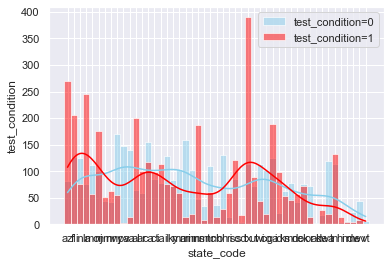

In [23]:
import seaborn as sns
from imblearn.over_sampling import SMOTENC

smote_nc = SMOTENC(categorical_features=[0,1,2], random_state=0)
X, y = smote_nc.fit_resample(X, y)

# ros = RandomOverSampler(random_state=0)
# X, y = ros.fit_resample(X, y)
X_0=X.loc[y==0]
X_1=X.loc[y==1]
sns.set(style="darkgrid")
x=X.columns[0]
y_name="test_condition"
sns.histplot(X_0[x],  color="skyblue", label="test_condition=0", kde=True)
sns.histplot(X_1[x], color="red", label="test_condition=1", kde=True)
plt.xlabel(x)
plt.ylabel(y_name)
# filename="scatter_plot\histogram_plot(0-5)"+"\{}.png".format(x)
plt.legend()
plt.show()
# plt.savefig(filename)

## Using Different undersampler method

In [11]:
# from imblearn.under_sampling import ClusterCentroids
# cc = ClusterCentroids(categorical_features=[0,1,2],random_state=0)
# X_resampled, y_resampled = cc.fit_resample(X, y)

## test_condition_分布隨日期變化

In [12]:
# for i in range(1000,5000,500):  
#     y=data.iloc[i:,length-1]
#     plt.hist(y,bins=10)
#     filename="test_condition_分布隨日期變化\ 最後{}".format(5000-i)
#     plt.savefig(filename) 
#     plt.close()  

## OneHotEncoder

In [13]:
# from sklearn.compose import make_column_selector as selector
# #將是type 是object的取出來:categorical_columns取出來的index
# categorical_columns_selector = selector(dtype_include=object)
# categorical_columns = categorical_columns_selector(data)


In [14]:
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler, OneHotEncoder
from sklearn import preprocessing
from sklearn.feature_selection import SelectKBest, chi2
from sklearn.model_selection import GridSearchCV
from sklearn.preprocessing import OneHotEncoder

In [15]:
# X_cat=X[categorical_columns]

# #onehotencoder使用 -> fit -> transform -> return array 
# enc =OneHotEncoder(sparse=False)
# enc.fit(X_cat)
# data_encoded=enc.transform(X_cat)
# #產生columns index的名稱
# columns_encoded = enc.get_feature_names(categorical_columns)
# X_categorical_columns=pd.DataFrame(data_encoded, columns=columns_encoded)

# X_withoutcategorical_columns=X.drop(categorical_columns,axis=1)

# X=pd.concat([X_withoutcategorical_columns, X_categorical_columns], axis=1)
# #onehotencoder之後


## Using Combination of over- and under-sampling method

In [16]:
# from imblearn.combine import SMOTEENN
# smote_enn = SMOTEENN(random_state=0)
# X, y = smote_enn.fit_resample(X, y)

,pct_ili,pct_cli_anosmia_ageusia,pct_hh_cli,pct_cmnty_cli,pct_hh_fever,pct_hh_sore_throat,pct_hh_cough,pct_hh_shortness_of_breath,pct_hh_difficulty_breathing,mean_hh_cli_ct,...,pct_diabetes_weighted,pct_cancer_weighted,pct_heart_disease_weighted,pct_high_blood_pressure_weighted,pct_asthma_weighted,pct_chronic_lung_disease_weighted,pct_kidney_disease_weighted,pct_autoimmune_disorder_weighted,pct_no_above_medical_conditions_weighted,pct_multiple_medical_conditions_weighted
0,2.092700,3.736900,3.043500,16.353709,3.623200,14.658900,25.362300,9.434000,4.934700,1.755853e+31,...,6.988500,4.878200,2.822600,20.989400,18.220900,3.639000,1.265600,12.472000,53.375500,16.555900
1,1.023900,2.559700,1.683500,16.353709,2.188600,11.952900,21.212100,7.251300,3.040500,1.755853e+31,...,8.922700,3.559500,4.585400,22.242800,15.584000,3.672200,2.512600,11.206900,56.899100,17.814000
2,0.000000,3.191500,1.020400,16.353709,1.020400,8.163300,15.306100,10.309300,4.081600,1.755853e+31,...,20.235900,8.365200,17.208700,63.327000,8.444800,7.639500,11.393900,4.432500,19.219000,38.073500
3,1.726400,3.320100,3.425600,16.353709,3.689100,16.754600,25.989400,9.090900,3.825900,1.755853e+31,...,3.321300,0.679600,0.479400,9.995200,19.020900,0.667700,1.215500,5.075100,66.573400,5.947900
4,0.230900,1.616600,0.457700,16.353709,0.915300,5.022800,17.123300,3.653000,1.369900,1.755853e+31,...,18.809800,13.279200,9.985200,50.930800,11.221400,11.802800,5.023200,13.025700,27.251000,36.809800
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7721,0.337838,0.000000,0.331800,13.090070,0.331800,1.146788,7.724592,4.115958,1.146788,1.048138e-01,...,12.259899,6.716228,9.767171,40.206479,18.510870,8.337669,6.040561,8.736429,34.234939,29.899907
7722,2.673809,4.980876,2.898391,34.417168,2.898391,12.973454,19.491909,7.904209,3.441083,1.460342e-01,...,11.685401,4.978898,3.334971,28.326238,19.478604,1.894111,2.477690,7.009357,50.910528,19.507753
7723,1.830351,6.589123,2.369102,35.602145,3.324040,10.369216,15.746734,7.249209,3.960618,2.447037e-01,...,14.279056,1.949492,3.879237,36.328017,19.809469,5.639033,1.341953,9.491686,41.542281,24.752120
7724,0.421173,2.141070,1.554701,15.890545,1.934649,3.885957,15.309260,6.358042,4.335622,2.550831e-01,...,15.987821,10.332715,8.909824,57.117174,12.789463,11.682163,1.706990,8.652941,26.142326,33.458503


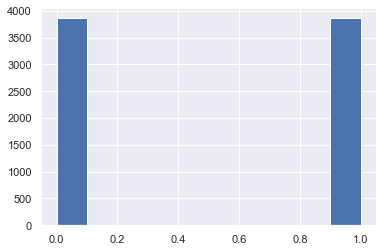

In [26]:
plt.hist(y,bins=10)
X=X.iloc[:,3:]
X

In [27]:
#Compare Algorithms
%matplotlib inline
from pandas import read_csv
from matplotlib import pyplot
from sklearn.model_selection import KFold
from sklearn.model_selection import cross_val_score
from sklearn.linear_model import LogisticRegression
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis
from sklearn.ensemble import BaggingClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.ensemble import AdaBoostClassifier

# load dataset
X=X
y=y

# prepare models
models = []
models.append(('LR', LogisticRegression(solver = 'liblinear')))
models.append(('LDA', LinearDiscriminantAnalysis()))
#
seed = 7
cart = DecisionTreeClassifier()
num_trees = 100
model = BaggingClassifier(base_estimator=cart, n_estimators=num_trees) 
models.append(('Bagging', model))
#
max_features = 3
model = RandomForestClassifier(n_estimators=num_trees, max_features=max_features) 
models.append(('RF', model))
#
num_trees = 30
model = AdaBoostClassifier(n_estimators=num_trees)
models.append(('AdaBoost', model))
# evaluate each model in turn
results = []
names = []
scoring = 'accuracy'
for name, model in models:
    kfold = KFold(n_splits=10)
    cv_results = cross_val_score(model, X, y, cv=kfold, scoring=scoring)
    results.append(cv_results)
    names.append(name)
    msg = "%s: %f (%f)" % (name, cv_results.mean(), cv_results.std())
    print(msg)
# boxplot algorithm comparison
fig = pyplot.figure() 
fig.suptitle('Algorithm Comparison') 
ax = fig.add_subplot(111) 
pyplot.boxplot(results) 
ax.set_xticklabels(names) 
pyplot.show()

In [103]:

from sklearn.metrics import mean_absolute_error
import xgboost as xgb
clf = xgb.XGBClassifier(objective= 'binary:logistic',eval_metric=mean_absolute_error,
    tree_method="gpu_hist",enable_categorical=True, use_label_encoder=False,
    seed=42)

# __Make Pipeline__

In [104]:
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler, OneHotEncoder
from sklearn import preprocessing
from sklearn.feature_selection import SelectKBest, chi2
from sklearn.model_selection import GridSearchCV
from sklearn.preprocessing import MinMaxScaler
from sklearn.impute import SimpleImputer
pipe = Pipeline([
                    
                ('scaler', StandardScaler()),
                
                ('min_max', preprocessing.MinMaxScaler(feature_range=(1, 1000))),
                ('feature_select',SelectKBest(chi2)),
                ('clf',clf)
                  ])
pipe.get_params().keys()

dict_keys(['memory', 'steps', 'verbose', 'scaler', 'min_max', 'feature_select', 'clf', 'scaler__copy', 'scaler__with_mean', 'scaler__with_std', 'min_max__clip', 'min_max__copy', 'min_max__feature_range', 'feature_select__k', 'feature_select__score_func', 'clf__objective', 'clf__use_label_encoder', 'clf__base_score', 'clf__booster', 'clf__colsample_bylevel', 'clf__colsample_bynode', 'clf__colsample_bytree', 'clf__enable_categorical', 'clf__gamma', 'clf__gpu_id', 'clf__importance_type', 'clf__interaction_constraints', 'clf__learning_rate', 'clf__max_delta_step', 'clf__max_depth', 'clf__min_child_weight', 'clf__missing', 'clf__monotone_constraints', 'clf__n_estimators', 'clf__n_jobs', 'clf__num_parallel_tree', 'clf__predictor', 'clf__random_state', 'clf__reg_alpha', 'clf__reg_lambda', 'clf__scale_pos_weight', 'clf__subsample', 'clf__tree_method', 'clf__validate_parameters', 'clf__verbosity', 'clf__eval_metric', 'clf__seed'])

## param_grid setting

In [110]:
from sklearn.model_selection import ShuffleSplit
# 參數篩選
feature_select__k=[100]#50,100,150,200 中100
# 
param_grid = { 
    
    'feature_select__k':feature_select__k,
    'clf__learning_rate': [0.05], 
    'clf__max_depth': [6], # 2,4,6中 6最好
    'clf__min_child_weight': [11],# 11,20,30中 11最好
    
    'clf__subsample': [0.8],#0.4,0.8中 0.8最好
    'clf__colsample_bytree': [0.7],
    'clf__n_estimators': [1000], #1000,2000,3000,4000,5000中 5000最好 越多越好
    "clf__gamma":[0.2] # 0.1,0.2,0.3中 0.2最好
    
}
# GridSearchCV : refit==True 會重新用整個data重新訓練一次
gs=GridSearchCV(estimator=clf,
               param_grid=param_grid,
               
            #    cv=ShuffleSplit(n_splits=5, test_size=0.3, random_state=0),
               cv=5,
               n_jobs = -1,
              )
gs=gs.fit(X,y)

c:\Users\Ian\Python_workspace\pyml\lib\site-packages\sklearn\model_selection\_search.py:922: UserWarning: One or more of the test scores are non-finite: [nan]
  warnings.warn(


[02:10:00] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.0/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.


# Store best_params_


In [111]:
# param_grid=gs.best_params_
# type(param_grid)
# for i in param_grid.keys():
#     param_grid[i]=[param_grid[i]]
# print(param_grid)
print(gs.best_params_)
print(gs.best_score_)

df=pd.DataFrame(gs.cv_results_)
print(df)
# df.to_excel("xgboost_cv_results.xlsx")

{'clf__colsample_bytree': 0.7, 'clf__gamma': 0.2, 'clf__learning_rate': 0.05, 'clf__max_depth': 6, 'clf__min_child_weight': 11, 'clf__n_estimators': 1000, 'clf__subsample': 0.8, 'feature_select__k': 100}
nan
   mean_fit_time  std_fit_time  mean_score_time  std_score_time  \
0      19.761203      0.355713         0.020186         0.00229   

  param_clf__colsample_bytree param_clf__gamma param_clf__learning_rate  \
0                         0.7              0.2                     0.05   

  param_clf__max_depth param_clf__min_child_weight param_clf__n_estimators  \
0                    6                          11                    1000   

   ... param_feature_select__k  \
0  ...                     100   

                                              params split0_test_score  \
0  {'clf__colsample_bytree': 0.7, 'clf__gamma': 0...          0.830292   

   split1_test_score  split2_test_score  split3_test_score  split4_test_score  \
0            0.89781           0.930657           

# 輸入test data

In [5]:

test=pd.read_csv("test_covid.csv")

"""
mean_hh_cli_ct                                            4784 non-null   float64
pct_worried_finances                                      0 non-null      float64
pct_cmnty_cli                                             4804 non-null   float64

"""
# test=test.drop(['date', 'state_code', 'gender', 'age_bucket',"mean_hh_cli_ct","pct_worried_finances","pct_cmnty_cli"],axis=1)

test=test.drop(["date","pct_worried_finances"],axis=1)


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 906 entries, 0 to 905
Data columns (total 96 columns):
 #   Column                                                    Non-Null Count  Dtype  
---  ------                                                    --------------  -----  
 0   date                                                      906 non-null    object 
 1   state_code                                                906 non-null    object 
 2   gender                                                    906 non-null    object 
 3   age_bucket                                                906 non-null    object 
 4   n                                                         906 non-null    int64  
 5   weight_sums                                               906 non-null    float64
 6   pct_cli                                                   906 non-null    float64
 7   pct_ili                                                   906 non-null    float64
 8   pct_cli_anosmia_ageu

## Use SimpleImputer 將nan用中位數替換

In [113]:
from sklearn.impute import SimpleImputer
imp_mean = SimpleImputer(missing_values=np.nan, strategy='mean')
#因為前三個欄位為str的type
test_num=test.iloc[:,3:]
test_num=imp_mean.fit_transform(test_num)
test.iloc[:,3:]=test_num
#確認是否nan都替換掉
test.isna().sum().sum()

0

## OneHotEncoder  還要再確認是否一致

In [1]:
categorical_columns_selector = selector(dtype_include=object)
categorical_columns = categorical_columns_selector(test)

X_test=test.iloc[:,0:test.shape[1]-1]

#onehotencoder使用 -> fit -> transform -> return array 
enc_test =OneHotEncoder(sparse=False)
enc_test.fit(X_test[categorical_columns])
data_encoded=enc_test.transform(X_test[categorical_columns])

#產生columns index的名稱
columns_encoded = enc_test.get_feature_names(categorical_columns)
X_categorical_columns=pd.DataFrame(data_encoded, columns=columns_encoded)

X_withoutcategorical_columns=X_test.drop(categorical_columns,axis=1)
#為了讓onehotencoder 的種類一樣
X_test=pd.concat([X_withoutcategorical_columns, X_categorical_columns], axis=1)
#onehotencoder之後
X_test.head()
X_test.columns
X_test=pd.DataFrame(X_test,columns=X.columns)
print(X_test.isna().sum().sum())
X_test=X_test.fillna(0)
print(X_test.isna().sum().sum())
X_test

NameError: name 'selector' is not defined

In [59]:
y.shape

(906,)

In [57]:
y_test.shape

(906,)

## learning curve

In [ ]:
from sklearn.model_selection import learning_curve
train_sizes, train_scores, valid_scores = learning_curve(
    gs.best_estimator_, X, y, train_sizes=[500, 800, 1100,4000], cv=5)
#gs.best_estimator_也可以當estimator
train_scores
valid_scores